In [6]:
import pandas as pd
from scipy.stats import ttest_ind
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt



In [37]:
pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)


In [33]:
df = pd.read_csv('final_data_cleaned.csv')

df['revenue_per_ride'] = df['price']

df['total_revenue_per_customer'] = df.groupby('ride_id')['revenue_per_ride'].transform('sum')

df['total_ride_duration_per_customer'] = df.groupby('ride_id')['ride_duration'].transform('sum')

average_revenue_per_ride = df['revenue_per_ride'].mean()

average_ride_duration = df['ride_duration'].mean()

average_revenue_per_user = df['total_revenue_per_customer'].mean()

average_ride_duration_per_user = df['total_ride_duration_per_customer'].mean()

clv = average_revenue_per_user * average_ride_duration_per_user

print(f"Average Revenue per Ride: ${average_revenue_per_ride:.2f}")
print(f"Average Ride Duration: {average_ride_duration:.2f} minutes")
print(f"Average Revenue per User: ${average_revenue_per_user:.2f}")
print(f"Average Ride Duration per User: {average_ride_duration_per_user:.2f} minutes")
print(f"Average Revenue Per Ride for 2 year period: ${clv:.2f}")

Average Revenue per Ride: $1.62
Average Ride Duration: 12.27 minutes
Average Revenue per User: $1.62
Average Ride Duration per User: 12.27 minutes
Average Revenue Per Ride for 2 year period: $19.84


In [5]:
start_date = pd.to_datetime('2022-01-01')
end_date = pd.to_datetime('2023-11-30')

df['started_at'] = pd.to_datetime(df['started_at'])
df['ended_at'] = pd.to_datetime(df['ended_at'])

df['testing_group'] = (df['ride_duration'] > 0) & (df['ride_duration'] < 21.828)

df['sign_up'] = df['testing_group'].apply(lambda x: 1 if x else 0)

control_group = df[df['testing_group'] == False]['sign_up']
testing_group = df[df['testing_group'] == True]['sign_up']

t_stat, p_value = ttest_ind(control_group, testing_group, equal_var=False)

if p_value < 0.05:
    print("Reject the null hypothesis. Users with rides between 0 and 21.82 minutes are more likely to sign up. I recommend that Citibike consider offering promotional discounts or targeted marketing strategies to this group of users increase sign-up rates and profits.")
else:
    print("Fail to reject the null hypothesis No significant impact observed.")

Reject the null hypothesis. Users with rides between 0 and 21.82 minutes are more likely to sign up. I recommend that Citibike consider offering promotional discounts or targeted marketing strategies to this group of users increase sign-up rates and profits.


/var/folders/mk/h0jn844j1wx1kd56qstth2gw0000gn/T/ipykernel_39588/3178006068.py:14: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  t_stat, p_value = ttest_ind(control_group, testing_group, equal_var=False)


No existing station found at location: 40.77327329478094, -73.96015086987678
No existing station found at location: 40.682165464240505, -73.97925867774099
No existing station found at location: 40.73588672801294, -73.99170231396585
No existing station found at location: 40.70943855225891, -73.94068589436058
No existing station found at location: 40.82689546072891, -73.92673351710893


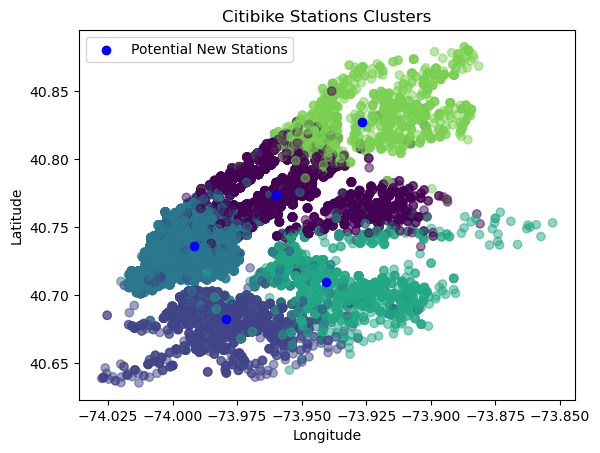

Cluster Centers (Potential New Station Locations):
   start_lat  start_lng    end_lat    end_lng
0  40.773273 -73.960151  40.773564 -73.959398
1  40.682165 -73.979259  40.682028 -73.979381
2  40.735887 -73.991702  40.735679 -73.991758
3  40.709439 -73.940686  40.709154 -73.940168
4  40.826895 -73.926734  40.826067 -73.926740


In [11]:
coordinates = df[['start_lat', 'start_lng', 'end_lat', 'end_lng']]

num_clusters = 5

kmeans = KMeans(n_clusters=num_clusters, random_state=50)
df['cluster'] = kmeans.fit_predict(coordinates)

colors = plt.cm.viridis(df['cluster'] / num_clusters)

plt.scatter(df['start_lng'], df['start_lat'], c=colors, alpha=0.5)
plt.title('Citibike Stations Clusters')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

existing_stations = df[['start_lng', 'start_lat']].drop_duplicates()

cluster_centers = pd.DataFrame(kmeans.cluster_centers_, columns=['start_lat', 'start_lng', 'end_lat', 'end_lng'])
plt.scatter(cluster_centers['start_lng'], cluster_centers['start_lat'], color='blue', marker='o', label='Potential New Stations')

for index, center in cluster_centers.iterrows():
    existing_station_at_location = existing_stations[
        (existing_stations['start_lat'] == center['start_lat']) &
        (existing_stations['start_lng'] == center['start_lng'])
    ]
    if not existing_station_at_location.empty:
        print(f"Existing station found at location: {center['start_lat']}, {center['start_lng']}")
    else:
        print(f"No existing station found at location: {center['start_lat']}, {center['start_lng']}")
        
plt.legend()
plt.show()

print("Cluster Centers (Potential New Station Locations):")
print(cluster_centers)

In [96]:
df.shape

(16097, 26)

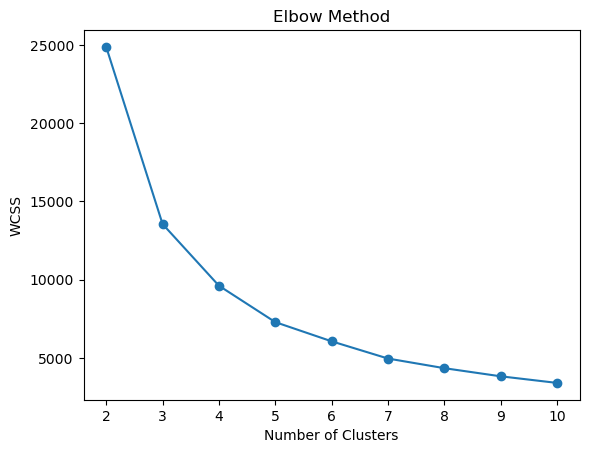

       start_zip  cluster_start_zip
0        10019.0                  5
1        10002.0                  0
2        10025.0                  2
3        10001.0                  0
4        11101.0                  1
...          ...                ...
16092    10023.0                  5
16093    10035.0                  2
16094    11233.0                  3
16095    10014.0                  0
16096    11211.0                  1

[16097 rows x 2 columns]


In [13]:
from sklearn.preprocessing import StandardScaler

# Load your Citibike dataset into a pandas DataFrame
# Assuming your dataset is stored in a variable called 'citibike_df'
# You may need to adjust the file path or loading mechanism accordingly
# Example: citibike_df = pd.read_csv('path/to/citibike_dataset.csv')

# Select relevant columns for k-means clustering
features = ['start_lat', 'start_lng', 'start_zip']

# Create a DataFrame with only the selected features
data_for_clustering = df[features]

# Standardize the data (important for k-means)
scaler = StandardScaler()
data_for_clustering_scaled = scaler.fit_transform(data_for_clustering)

# Determine the optimal number of clusters using the Elbow Method
# Here, I'll choose a range of cluster numbers from 2 to 10
wcss = []  # Within-cluster sum of squares

for i in range(2, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', random_state=42)
    kmeans.fit(data_for_clustering_scaled)
    wcss.append(kmeans.inertia_)

# Plot the Elbow Method to find the optimal number of clusters
plt.plot(range(2, 11), wcss, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')  # Within-cluster sum of squares
plt.show()

# Based on the Elbow Method, choose the optimal number of clusters
# In this example, let's say the elbow is around 4 clusters

# Apply k-means clustering with the chosen number of clusters
num_clusters = 6
kmeans = KMeans(n_clusters=num_clusters, init='k-means++', random_state=42)
df['cluster_start_zip'] = kmeans.fit_predict(data_for_clustering_scaled)

# Display the cluster assignments
print(df[['start_zip', 'cluster_start_zip']])

# You can analyze and visualize the results further based on your requirements


In [16]:
df.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,ride_duration,start_zip,price,end_zip,start_day_of_week,start_hour,end_hour,start_month,start_season,ride_duration_category,revenue_per_ride,total_revenue_per_customer,total_ride_duration_per_customer,testing_group,sign_up,cluster,cluster_start_zip
0,3510255EC224A971,electric_bike,2023-08-01 00:37:00,2023-08-01 00:53:00,Broadway & W 58 St,6948.1,Morningside Dr & Amsterdam Ave,7741.04,40.766953,-73.981693,40.810285,-73.957365,casual,15.65,10019.0,8.559,10027.0,Tuesday,0.0,0.0,8.0,Summer,Long,8.559,8.559,15.65,True,1,0,5
1,4F68D8A99EDAC92B,classic_bike,2023-08-01 01:15:00,2023-08-01 01:30:00,Allen St & Hester St,5342.1,John St & William St,5065.04,40.716009,-73.991952,40.708621,-74.007222,member,15.27,10002.0,0.000,10038.0,Tuesday,1.0,1.0,8.0,Summer,Long,0.000,0.000,15.27,True,1,2,0
2,E5005E70D0099A96,classic_bike,2023-08-01 02:57:00,2023-08-01 03:19:00,W 106 St & Amsterdam Ave,7634.01,Madison Ave & E 120 St,7667.04,40.800836,-73.966449,40.802950,-73.942954,member,21.87,10025.0,0.000,10035.0,Tuesday,2.0,3.0,8.0,Summer,Very Long,0.000,0.000,21.87,False,0,0,2
3,9010CDC8C004135E,classic_bike,2023-08-01 03:14:00,2023-08-01 03:19:00,W 27 St & 7 Ave,6247.06,Lexington Ave & E 26 St,6089.08,40.746647,-73.993915,40.741459,-73.983293,member,5.30,10001.0,0.000,10035.0,Tuesday,3.0,3.0,8.0,Summer,Short,0.000,0.000,5.30,True,1,2,0
4,E526EF90BBD8CB0F,classic_bike,2023-08-01 04:41:00,2023-08-01 04:48:00,44 Dr & Jackson Ave,6352.01,36 Ave & 31 St,6572.08,40.747067,-73.943227,40.756513,-73.929575,member,6.87,11101.0,0.000,11106.0,Tuesday,4.0,4.0,8.0,Summer,Short,0.000,0.000,6.87,True,1,0,1


In [17]:
df_price_clust = pd.DataFrame({
    'Price': df['price'],
    'Cluster': df['cluster_start_zip'],
    'start_zip': df['start_zip']
})


df_price_clust

,Price,Cluster,start_zip
0,8.559,5,10019.0
1,0.000,0,10002.0
2,0.000,2,10025.0
3,0.000,0,10001.0
4,0.000,1,11101.0
...,...,...,...
16092,0.000,5,10023.0
16093,0.000,2,10035.0
16094,4.490,3,11233.0
16095,4.490,0,10014.0


In [25]:
# Assuming your DataFrame is named 'df_price_clust'
# df = ...

# Calculate revenue for each ride (price multiplied by the number of rides)
df_price_clust['revenue'] = df_price_clust['Price']

# Group by cluster and sum the revenue
cluster_revenue = df_price_clust.groupby('Cluster')['revenue'].sum()

# Find the cluster with the highest revenue
max_revenue_cluster = cluster_revenue.idxmax()
max_revenue_value = cluster_revenue.max()

print(f"Cluster {max_revenue_cluster} has the highest revenue: ${max_revenue_value}")

# df_most_revenue_zips = (df_price_clust[df_price_clust['Cluster'] == 0]['start_zip']).drop_duplicates(subset=['start_zip'])

display((df_price_clust[df_price_clust['Cluster'] == 0]['start_zip']).unique())

Cluster 0 has the highest revenue: $7595.1525


array([10002., 10001., 10009., 10003., 10012., 10011., 10282., 10014.,
       10013., 10280., 10281., 10005., 10007., 10010., 10019., 10004.,
       10038., 10285., 10000., 10048., 10275., 10035., 10006., 10279.,
       10045., 10018., 10278., 10021.])

In [26]:
df_price_clust['revenue_by_zip'] = df_price_clust['Price']
cluster_revenue_zip = df_price_clust.groupby('start_zip')['revenue_by_zip'].sum()

max_revenue_zip = cluster_revenue_zip.idxmax()
max_revenue_value = cluster_revenue_zip.max()

print(f"Zip {max_revenue_zip} has the highest revenue: ${max_revenue_value}")


Zip 10019.0 has the highest revenue: $1305.1064


In [29]:
df_zips_uni = df['start_zip'].unique()

display(df_zips_uni)



array([10019., 10002., 10025., 10001., 11101., 10128., 11217., 11205.,
       10036., 11213., 10009., 10010., 11377., 10003., 10012., 10011.,
       10282., 11218., 10029., 11242., 11221., 10075., 11201., 11238.,
       10014., 10026., 10111., 10065., 10034., 10105., 10022., 11233.,
       11378., 10033., 10013., 10280., 10037., 10281., 11249., 10005.,
       10199., 10023., 11222., 10016., 11106., 11237., 11231., 10035.,
       11102., 11211., 10017., 11251., 10007., 11207., 11232., 10028.,
       10458., 11216., 11220., 10040., 10031., 11226., 10024., 11215.,
       10120., 10039., 10106., 10032., 10205., 10451., 10456., 11203.,
       11105., 10018., 10122., 11385., 10027., 10459., 10452., 10021.,
       11415., 10115., 11103., 10454., 10468., 10004., 10069., 10153.,
       11206., 10038., 10285., 10457., 11225., 11109., 11373., 10453.,
       11227., 10030., 10467., 10000., 11104., 10048., 10455., 10174.,
       10275., 10155., 11209., 10006., 11369., 10460., 10172., 11235.,
      

In [32]:
df_zips_list = df_zips_uni.tolist()
nyc_all_zips = [10001, 10451, 10002, 10452, 10003, 10453, 10004, 10454, 10005, 10455, 10006, 10456, 10007, 10457, 10009, 10458, 10010, 10459, 10011, 10460, 10012, 10461, 10013, 10462, 10014, 10463, 10015, 10464, 10016, 10465, 10017, 10466, 10018, 10467, 10019, 10468, 10020, 10469, 10021, 10470, 10022, 10471, 10023, 10472, 10024, 10473, 10025, 10474, 10026, 10475, 10027, 11201, 10028, 11203, 10029, 11204, 10030, 11205, 10031, 11206, 10032, 11207, 10033, 11208, 10034, 11209, 10035, 11210, 10036, 11211, 10037, 11212, 10038, 11213, 10039, 11214, 10040, 11215, 10041, 11216, 10044, 11217, 10045, 11218, 10048, 11219, 10055, 11220, 10060, 11221, 10069, 11222, 10090, 11223, 10095, 11224, 10098, 11225, 10099, 11226, 10103, 11228, 10104, 11229, 10105, 11230, 10106, 11231, 10107, 11232, 10110, 11233, 10111, 11234, 10112, 11235, 10115, 11236, 10118, 11237, 10119, 11238, 10120, 11239, 10121, 11241, 10122, 11242, 10123, 11243, 10128, 11249, 10151, 11252, 10152, 11256, 10153, 10001, 10154, 10002, 10155, 10003, 10158, 10004, 10161, 10005, 10162, 10006, 10165, 10007, 10166, 10009, 10167, 10010, 10168, 10011, 10169, 10012, 10170, 10013, 10171, 10014, 10172, 10015, 10173, 10016, 10174, 10017, 10175, 10018, 10176, 10019, 10177, 10020, 10178, 10021, 10199, 10022, 10270, 10023, 10271, 10024, 10278, 10025, 10279, 10026, 10280, 10027, 10281, 10028, 10282, 10029, 10301, 10030, 10302, 10031, 10303, 10032, 10304, 10033, 10305, 10034, 10306, 10035, 10307, 10036, 10308, 10037, 10309, 10038, 10310, 10039, 10311, 10040, 10312, 10041, 10314, 10044, 10451, 10045, 10452, 10048, 10453, 10055, 10454, 10060, 10455, 10069, 10456, 10090, 10457, 10095, 10458, 10098, 10459, 10099, 10460, 10103, 10461, 10104, 10462, 10105, 10463, 10106, 10464, 10107, 10465, 10110, 10466, 10111, 10467, 10112, 10468, 10115, 10469, 10118, 10470, 10119, 10471, 10120, 10472, 10121, 10473, 10122, 10474, 10123, 10475, 10128, 11004, 10151, 11101, 10152, 11102, 10153, 11103, 10154, 11104, 10155, 11105, 10158, 11106, 10161, 11109, 10162, 11201, 10165, 11203, 10166, 11204, 10167, 11205, 10168, 11206, 10169, 11207, 10170, 11208, 10171, 11209, 10172, 11210, 10173, 11211, 10174, 11212, 10175, 11213, 10176, 11214, 10177, 11215, 10178, 11216, 10199, 11217, 10270, 11218, 10271, 11219, 10278, 11220, 10279, 11221, 10280, 11222, 10281, 11223, 10282, 11224, 11101, 11225, 11102, 11226, 11103, 11228, 11004, 11229, 11104, 11230, 11105, 11231, 11106, 11232, 11109, 11233, 11351, 11234, 11354, 11235, 11355, 11236, 11356, 11237, 11357, 11238, 11358, 11239, 11359, 11241, 11360, 11242, 11361, 11243, 11362, 11249, 11363, 11252, 11364, 11256, 11365, 11351, 11366, 11354, 11367, 11355, 11368, 11356, 11369, 11357, 11370, 11358, 11371, 11359, 11372, 11360, 11373, 11361, 11374, 11362, 11375, 11363, 11377, 11364, 11378, 11365, 11379, 11366, 11385, 11367, 11411, 11368, 11412, 11369, 11413, 11370, 11414, 11371, 11415, 11372, 11416, 11373, 11417, 11374, 11418, 11375, 11419, 11377, 11420, 11378, 11421, 11379, 11422, 11385, 11423, 11411, 11426, 11412, 11427, 11413, 11428, 11414, 11429, 11415, 11430, 11416, 11432, 11417, 11433, 11418, 11434, 11419, 11435, 11420, 11436, 11421, 11691, 11422, 11692, 11423, 11693, 11426, 11694, 11427, 11697, 11428, 10301, 11429, 10302, 11430, 10303, 11432, 10304, 11433, 10305, 11434, 10306, 11435, 10307, 11436, 10308, 11691, 10309, 11692, 10310, 11693, 10311, 11694, 10312, 11697]

not_in_df = [x for x in nyc_all_zips if x not in df_zips_list]



print(not_in_df)

print(len(df_zips_list))

[10461, 10462, 10015, 10464, 10465, 10466, 10469, 10470, 10471, 10473, 10475, 11204, 11210, 11214, 10041, 11219, 10060, 10090, 11223, 10095, 11224, 10098, 10099, 10103, 11228, 10104, 11229, 11230, 10110, 11234, 10112, 10118, 11239, 10121, 11241, 10123, 11243, 10151, 11252, 10152, 11256, 10161, 10162, 10165, 10166, 10167, 10168, 10169, 10170, 10171, 10015, 10173, 10175, 10176, 10177, 10178, 10270, 10271, 10301, 10302, 10303, 10304, 10305, 10306, 10307, 10308, 10309, 10310, 10311, 10312, 10041, 10314, 10060, 10090, 10095, 10098, 10099, 10103, 10461, 10104, 10462, 10464, 10465, 10110, 10466, 10112, 10469, 10118, 10470, 10471, 10121, 10473, 10123, 10475, 11004, 10151, 10152, 10161, 10162, 10165, 10166, 11204, 10167, 10168, 10169, 10170, 10171, 11210, 10173, 10175, 10176, 11214, 10177, 10178, 10270, 10271, 11219, 11223, 11224, 11228, 11004, 11229, 11230, 11351, 11234, 11354, 11355, 11356, 11357, 11358, 11239, 11359, 11241, 11360, 11361, 11243, 11362, 11363, 11252, 11364, 11256, 11365, 11351

In [35]:
display(df.head())

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual,ride_duration,start_zip,price,end_zip,start_day_of_week,start_hour,end_hour,start_month,start_season,ride_duration_category,revenue_per_ride,total_revenue_per_customer,total_ride_duration_per_customer
0,3510255EC224A971,electric_bike,8/1/23 0:37,8/1/23 0:53,Broadway & W 58 St,6948.1,Morningside Dr & Amsterdam Ave,7741.04,40.766953,-73.981693,40.810285,-73.957365,casual,15.65,10019.0,8.559,10027.0,Tuesday,0.0,0.0,8.0,Summer,Long,8.559,8.559,15.65
1,4F68D8A99EDAC92B,classic_bike,8/1/23 1:15,8/1/23 1:30,Allen St & Hester St,5342.1,John St & William St,5065.04,40.716009,-73.991952,40.708621,-74.007222,member,15.27,10002.0,0.000,10038.0,Tuesday,1.0,1.0,8.0,Summer,Long,0.000,0.000,15.27
2,E5005E70D0099A96,classic_bike,8/1/23 2:57,8/1/23 3:19,W 106 St & Amsterdam Ave,7634.01,Madison Ave & E 120 St,7667.04,40.800836,-73.966449,40.802950,-73.942954,member,21.87,10025.0,0.000,10035.0,Tuesday,2.0,3.0,8.0,Summer,Very Long,0.000,0.000,21.87
3,9010CDC8C004135E,classic_bike,8/1/23 3:14,8/1/23 3:19,W 27 St & 7 Ave,6247.06,Lexington Ave & E 26 St,6089.08,40.746647,-73.993915,40.741459,-73.983293,member,5.30,10001.0,0.000,10035.0,Tuesday,3.0,3.0,8.0,Summer,Short,0.000,0.000,5.30
4,E526EF90BBD8CB0F,classic_bike,8/1/23 4:41,8/1/23 4:48,44 Dr & Jackson Ave,6352.01,36 Ave & 31 St,6572.08,40.747067,-73.943227,40.756513,-73.929575,member,6.87,11101.0,0.000,11106.0,Tuesday,4.0,4.0,8.0,Summer,Short,0.000,0.000,6.87


In [39]:
df_price_clust['member_casual'] = df['member_casual']


display(df_price_clust.head())

,Price,Cluster,start_zip,revenue,revenue_by_zip,member_casual
0,8.559,5,10019.0,8.559,8.559,casual
1,0.000,0,10002.0,0.000,0.000,member
2,0.000,2,10025.0,0.000,0.000,member
3,0.000,0,10001.0,0.000,0.000,member
4,0.000,1,11101.0,0.000,0.000,member


In [40]:
display(df_price_clust[df_price_clust['Cluster'] == 0]['member_casual'].value_counts())

member    4076
casual     971
Name: member_casual, dtype: int64

In [44]:
df_price_clust['bike_type'] = df['rideable_type']

In [46]:
revenue_by_member_casual = df_price_clust.groupby(['member_casual', 'Cluster', 'bike_type'])['revenue'].sum()

# Display the resulting DataFrame
print("Revenue by member_casual and cluster:")
print(revenue_by_member_casual)

Revenue by member_casual and cluster:
member_casual  Cluster  bike_type    
casual         0        classic_bike     3940.4010
                        electric_bike    1886.7770
               1        classic_bike     2445.5938
                        electric_bike    1203.3906
               2        classic_bike     1414.7978
                        electric_bike     979.6584
               3        classic_bike     1676.8056
                        electric_bike    1029.2456
               4        classic_bike      540.6872
                        electric_bike     456.1378
               5        classic_bike     2544.3342
                        electric_bike    1556.8248
member         0        classic_bike      430.2547
                        electric_bike    1337.7198
               1        classic_bike      236.5533
                        electric_bike     704.9356
               2        classic_bike      250.9183
                        electric_bike     719.0456
      

In [49]:
df_page_rank = df[['start_zip','end_zip']]

df_page_rank['count'] = 

/var/folders/mk/h0jn844j1wx1kd56qstth2gw0000gn/T/ipykernel_39588/2044060829.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_page_rank['count'] = 1


In [50]:
import pandas as pd
import networkx as nx

# Assuming your DataFrame is named 'df'
# df = ...

# Create a directed graph from the DataFrame
G = nx.from_pandas_edgelist(df_page_rank, 'start_zip', 'end_zip', create_using=nx.DiGraph())

# Calculate PageRank
pagerank_scores = nx.pagerank(G)

# Convert pagerank_scores to a DataFrame for better visualization
pagerank_df = pd.DataFrame(list(pagerank_scores.items()), columns=['zip_code', 'pagerank'])

# Sort the DataFrame by PageRank score in descending order
pagerank_df = pagerank_df.sort_values(by='pagerank', ascending=False)

# Display the DataFrame
print("PageRank scores for each ZIP code:")
print(pagerank_df)


PageRank scores for each ZIP code:
     zip_code  pagerank
0     10019.0  0.017662
6     10001.0  0.017395
5     10035.0  0.017269
25    10003.0  0.016510
2     10002.0  0.016137
16    10016.0  0.015825
7     11101.0  0.015195
40    10014.0  0.015024
20    10023.0  0.014362
49    10022.0  0.014287
44    10065.0  0.014057
54    10013.0  0.014024
27    10011.0  0.013672
19    10009.0  0.013568
64    11211.0  0.013339
15    10036.0  0.013214
66    10021.0  0.013088
70    10017.0  0.012997
26    10012.0  0.012872
61    11222.0  0.012821
34    11221.0  0.012554
80    11206.0  0.011477
21    10010.0  0.011439
22    10018.0  0.011414
37    11201.0  0.011395
24    11231.0  0.010980
12    11215.0  0.010979
3     10038.0  0.010882
9     10128.0  0.010826
76    10024.0  0.010606
28    10282.0  0.010579
1     10027.0  0.010324
68    11207.0  0.010283
8     11106.0  0.010276
13    11205.0  0.010252
74    10007.0  0.010100
67    11237.0  0.009823
17    11213.0  0.009730
47    10031.0  0.009696
4    

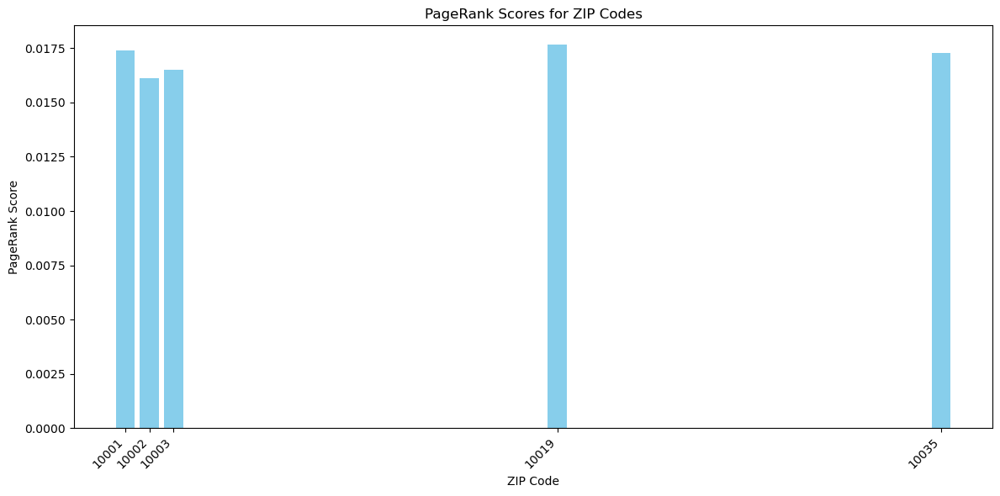

In [66]:
plt.figure(figsize=(12, 6))
plt.bar(pagerank_df.sort_values(by='pagerank', ascending=False)['zip_code'][0:5], pagerank_df.sort_values(by='pagerank', ascending=False)['pagerank'][0:5], color='skyblue')
plt.xlabel('ZIP Code')
plt.ylabel('PageRank Score')
plt.title('PageRank Scores for ZIP Codes')
plt.xticks(rotation=45, ha='right')
plt.xticks(pagerank_df.sort_values(by='pagerank', ascending=False)['zip_code'][0:5])
plt.tight_layout()
plt.show()

In [53]:
plt.figure(figsize=(100, 100))
pos = nx.spring_layout(G)  # You can use other layout algorithms based on your preference

# Draw nodes and edges
nx.draw(G, pos, with_labels=True, node_size=100, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', arrowsize=10)

# Add labels and title
plt.title('Directed Graph of Rides between ZIP Codes')
plt.show()

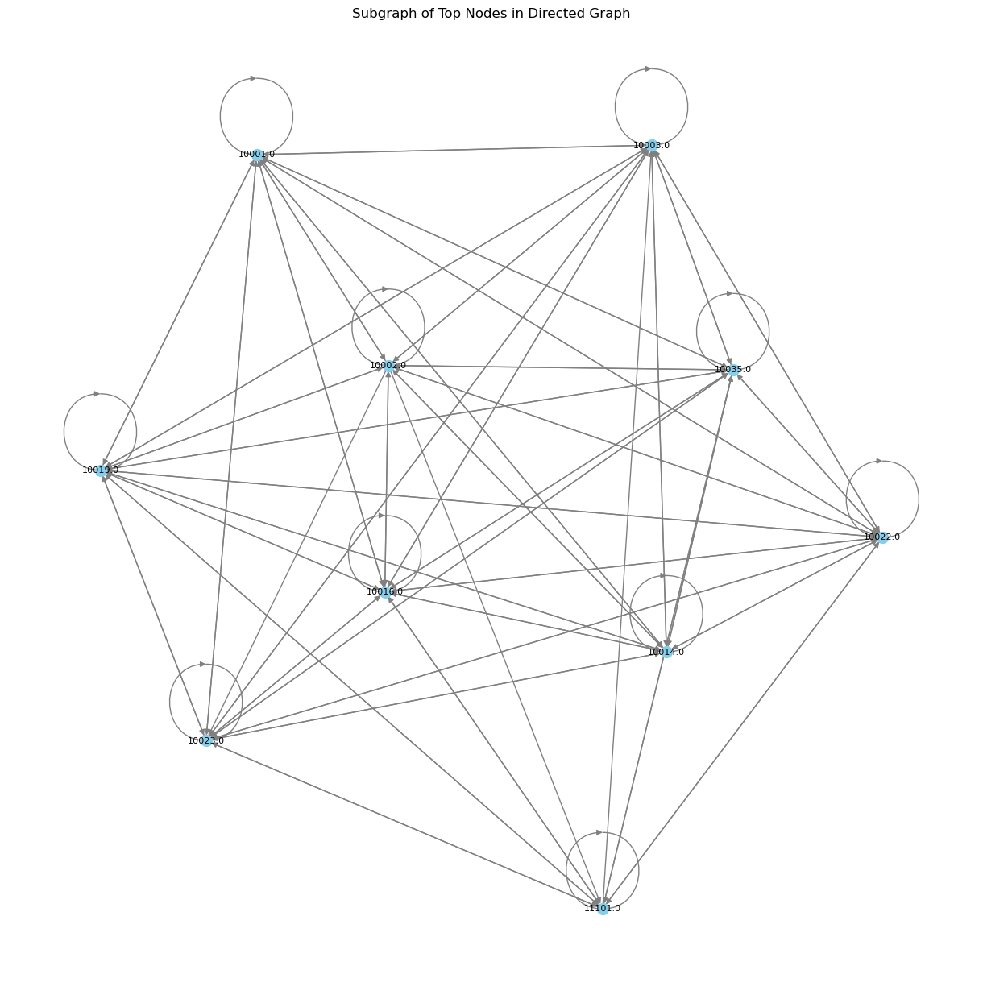

In [54]:
top_nodes = [node for node, _ in sorted(nx.pagerank(G).items(), key=lambda x: x[1], reverse=True)[:10]]

# Create a subgraph with the chosen nodes and their edges
subgraph = G.subgraph(top_nodes)

# Visualize the subgraph
plt.figure(figsize=(12, 12))
pos = nx.spring_layout(subgraph)  # You can use other layout algorithms based on your preference

# Draw nodes and edges
nx.draw(subgraph, pos, with_labels=True, node_size=100, font_size=8, font_color='black', node_color='skyblue', edge_color='gray', arrowsize=10)

# Add labels and title
plt.title('Subgraph of Top Nodes in Directed Graph')
plt.show()

Centrality Scores:

Highest In-Degree Centrality Scores:
    station  in_degree_centrality  out_degree_centrality
0   10019.0              0.439394               0.484848
6   10001.0              0.431818               0.386364
5   10035.0              0.424242               0.371212
25  10003.0              0.401515               0.424242
16  10016.0              0.393939               0.378788

Highest Out-Degree Centrality Scores:
    station  in_degree_centrality  out_degree_centrality
0   10019.0              0.439394               0.484848
2   10002.0              0.378788               0.439394
25  10003.0              0.401515               0.424242
15  10036.0              0.310606               0.416667
40  10014.0              0.386364               0.401515


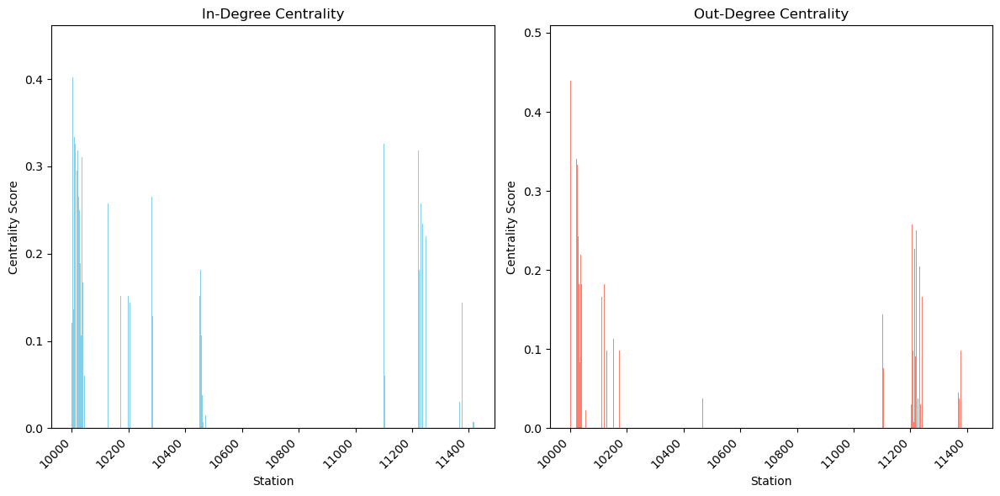

In [63]:
in_degree_centrality = nx.in_degree_centrality(G)
out_degree_centrality = nx.out_degree_centrality(G)

# Convert centrality scores to a DataFrame for better visualization
centrality_df = pd.DataFrame({
    'station': list(in_degree_centrality.keys()),
    'in_degree_centrality': list(in_degree_centrality.values()),
    'out_degree_centrality': list(out_degree_centrality.values())
})

# Display the DataFrame
print("Centrality Scores:")
print("\nHighest In-Degree Centrality Scores:")
print(centrality_df.sort_values(by='in_degree_centrality', ascending=False)[0:5])
print("\nHighest Out-Degree Centrality Scores:")
print(centrality_df.sort_values(by='out_degree_centrality', ascending=False)[0:5])


# Visualize the centrality scores
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.bar(centrality_df['station'], centrality_df['in_degree_centrality'], color='skyblue')
plt.title('In-Degree Centrality')
plt.xlabel('Station')
plt.ylabel('Centrality Score')
plt.xticks(rotation=45, ha='right')

plt.subplot(1, 2, 2)
plt.bar(centrality_df['station'], centrality_df['out_degree_centrality'], color='salmon')
plt.title('Out-Degree Centrality')
plt.xlabel('Station')
plt.ylabel('Centrality Score')
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()

In [94]:
df_rev_zip = df_price_clust.groupby(by='start_zip')['Price'].sum().sort_values(ascending=False)

display((df_rev_zip.mean()/700)*2800000)


display(df_rev_zip)

783030.315789474

start_zip
10019.0    1305.1064
10014.0    1048.1607
10009.0     999.0903
10002.0     915.2031
10011.0     845.3486
11211.0     825.2508
10003.0     816.7574
10001.0     665.0370
10016.0     636.1033
11237.0     602.4877
11221.0     600.1202
10012.0     554.3530
10036.0     544.9755
10013.0     531.8080
10023.0     509.1731
11249.0     461.3552
10024.0     459.7798
11222.0     426.4876
10025.0     407.2389
11201.0     372.3378
11215.0     369.5004
10035.0     359.3580
10128.0     358.9163
11206.0     343.4587
11217.0     335.5815
11238.0     330.2120
10022.0     306.0809
11207.0     296.8408
10010.0     292.4609
10021.0     287.8318
11101.0     279.3370
11231.0     259.2631
11216.0     256.2229
10018.0     250.2656
11205.0     219.9880
11385.0     219.6723
10028.0     217.4839
10017.0     209.4471
10026.0     206.6660
10282.0     206.2378
11233.0     206.2077
10027.0     206.1322
10037.0     204.2768
10456.0     199.3049
10029.0     194.5266
10038.0     186.7063
11106.0     184.3342
111

In [88]:
df_mem_zip = df_price_clust.groupby(by='start_zip')['member_casual'].value_counts().reset_index(name='count')
df_pivoted = df_mem_zip.pivot_table(index='start_zip', columns='member_casual', values='count', fill_value=0).reset_index()

# Rename the columns for clarity
df_pivoted.columns.name = None  # Remove the columns name created by pivot_table
df_pivoted.columns = ['start_zip', 'member_count', 'casual_count']

# Display the resulting DataFrame
print("Pivoted DataFrame:")
print(df_pivoted.sort_values(by='member_count', ascending=False))

Pivoted DataFrame:
     start_zip  member_count  casual_count
17     10019.0           149           603
13     10014.0           136           433
8      10009.0           125           607
3      10003.0           115           540
2      10002.0           106           522
10     10011.0           106           590
100    11211.0            96           265
11     10012.0            86           244
14     10016.0            82           384
118    11237.0            80           144
1      10001.0            78           400
108    11221.0            76           190
12     10013.0            66           243
109    11222.0            59           203
121    11249.0            57           172
34     10036.0            57           303
93     11201.0            55           222
21     10023.0            54           300
105    11217.0            54           181
96     11206.0            52           124
33     10035.0            47           249
23     10025.0            45       

In [98]:
len(df.columns)

26